# Import libraries

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import folium

from sklearn.ensemble import RandomForestClassifier
from sklearn.inspection import permutation_importance
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, classification_report

import joblib

import time
import os

# Import Data

In [2]:
# Direct path to file - update as needed 
file_df_290_large='/Users/ze/Desktop/Sample Data/v5_20240127_090226_290m.csv'

# Create dataframe from filepath 
df_290_large=pd.read_csv(file_df_290_large)

In [3]:
# current df to work on
df=df_290_large

In [4]:
# Verify 
df

,Timestamp,accelX(g),accelY(g),accelZ(g),accelUserX(g),accelUserY(g),accelUserZ(g),gyroX(rad/s),gyroY(rad/s),gyroZ(rad/s),...,ActivityType,ActivityConfidence,Pressure(kilopascals),RelativeAltitude(meters),magX(µT),magY(µT),magZ(µT),calMagX(µT),calMagY(µT),calMagZ(µT)
0,27-Jan-2024 09:02:26.235,0.0707,-0.7853,-0.7675,-0.0760,-0.0104,-0.0934,0.2487,-0.1251,-0.0299,...,Unknown,High,79.0262,0.4069,466.8752,-91.0777,-204.6161,0.0000,0.0000,0.0000
1,27-Jan-2024 09:02:26.237,0.0707,-0.7853,-0.7675,-0.0760,-0.0104,-0.0934,0.2487,-0.1251,-0.0299,...,Unknown,High,79.0262,0.4069,466.8752,-91.0777,-204.6161,0.0000,0.0000,0.0000
2,27-Jan-2024 09:02:26.237,0.0707,-0.7853,-0.7675,-0.0760,-0.0104,-0.0934,0.2487,-0.1251,-0.0299,...,Unknown,High,79.0262,0.4069,466.8879,-91.1979,-204.5525,0.0000,0.0000,0.0000
3,27-Jan-2024 09:02:26.244,0.1115,-0.7987,-0.7088,0.0767,-0.0485,-0.0485,0.2422,-0.1950,-0.0104,...,Unknown,High,79.0262,0.4069,466.8879,-91.1979,-204.5525,-20.0916,-30.5932,-34.9095
4,27-Jan-2024 09:02:26.253,0.1349,-0.7999,-0.6682,0.1016,-0.0483,-0.0095,0.2204,-0.2502,0.0258,...,Unknown,High,79.0262,0.4069,466.8879,-91.1979,-204.5525,-20.1807,-30.7355,-34.9763
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1738851,27-Jan-2024 13:52:49.562,0.0156,-0.4795,-0.8797,-0.0008,-0.0014,0.0050,-0.1426,0.0971,-0.0341,...,Unknown,High,84.8844,-578.8186,502.4919,-72.0238,-215.2970,14.1045,-8.7295,-50.9818
1738852,27-Jan-2024 13:52:49.572,0.0152,-0.4844,-0.8845,-0.0200,0.0069,-0.0067,-0.1252,0.0703,-0.0526,...,Unknown,High,84.8844,-578.8186,502.4919,-72.0238,-215.2970,14.0885,-8.6726,-51.0960
1738853,27-Jan-2024 13:52:49.582,0.0305,-0.4939,-0.8851,-0.0209,0.0010,-0.0109,-0.1043,0.0173,-0.0562,...,Unknown,High,84.8844,-578.8186,502.7928,-71.8565,-215.0498,14.1485,-8.5650,-50.9335
1738854,27-Jan-2024 13:52:49.593,0.0492,-0.4908,-0.8879,0.0130,-0.0062,-0.0139,-0.0603,-0.0315,-0.0522,...,Unknown,High,84.8844,-578.8186,502.7928,-71.8565,-215.0498,14.3427,-8.5697,-51.0119


# Helper functions

In [5]:
def convert_datetime(df):

    # Convert 'Timestamp' column to datetime format
    df['Timestamp'] = pd.to_datetime(df['Timestamp'], unit='ns')

    return df

In [6]:
def reduce_sampling_rate(df):
    df.set_index('Timestamp', inplace=True)
    # Set the 'Timestamp' column as the DataFrame's index
    df_resampled = df.resample('S').first()
    # Reset the index to create a standard numerical index
    df_resampled.reset_index(inplace=True)
    return df_resampled

In [7]:
def plot_total_alt_over_time(df, plot_title='Total Tracked Altitude Over Time'):

    # Create the scatter plot using Plotly Express
    fig = px.scatter(df,
                     x=df['Timestamp'],
                     y=df['Alt(m)'])

    # Update the layout with title and axis labels
    fig.update_layout(
            title='Altitude over Time',
            xaxis_title='Timestamp',
            yaxis_title='Altitude (m)',
            coloraxis_colorbar=dict(title='Cluster Label'),
            width=1000,
            height=600
        )

    # Show the Plotly figure
    fig.show()

In [8]:
def plot_manual_labeling(df):
    # Plot for Altitude over Time, colored by 'on_lift' status
    plt.figure(figsize=(15, 10))

    # Plot points where 'on_lift' is 1 with one color
    plt.scatter(df.loc[df['on_lift'] == 1, 'Timestamp'],
                df.loc[df['on_lift'] == 1, 'Alt(m)'],
                c='red',
                label='On the lift',
                marker='o')

    # Plot points where 'on_lift' is 0 with another color
    plt.scatter(df.loc[df['on_lift'] == 0, 'Timestamp'],
                df.loc[df['on_lift'] == 0, 'Alt(m)'],
                c='blue',
                label='Not on the lift',
                marker='o')

    plt.title('Labeled Data')
    plt.xlabel('Timestamp')
    plt.ylabel('Altitude (m)')
    plt.legend()
    plt.show()

In [9]:
def map_lift_rides(df):
    # Create a map centered on the mean latitude and longitude
    map_center = [df['Lat'].mean(),
                  df['Long'].mean()]
    mymap = folium.Map(location=map_center, zoom_start=10)

    # Plot data points with on_lift type
    on_lift = df[df['on_lift'] == 1]
    for index, row in on_lift.iterrows():
        folium.CircleMarker(location=[row['Lat'],
                                      row['Long']],
                            radius=5,
                            color='red',
                            fill=True,
                            fill_color='red',
                            tooltip=str(row['Timestamp'])).add_to(mymap)

    # Plot data points with not_on_lift types
    not_on_lift = df[df['on_lift'] != 1]
    for index, row in not_on_lift.iterrows():
        folium.CircleMarker(location=[row['Lat'],
                                      row['Long']],
                            radius=5,
                            color='blue',
                            fill=True,
                            fill_color='blue',
                            tooltip=str(row['Timestamp'])).add_to(mymap)

    # Return the map object
    return mymap


In [10]:
#Map all tracked movement based on lat and long of GPS data

def map_tracked_movement(df, zoom_start=12):
    # Create a map centered on the mean latitude and longitude
    map_center = [df['Lat'].mean(), df['Long'].mean()]
    movement_on_map = folium.Map(location=map_center, zoom_start=zoom_start)

    # Add CircleMarkers for each data point
    for index, row in df.iterrows():
        folium.CircleMarker(location=[
                            row['Lat'], 
                            row['Long']], 
                            radius=5, 
                            color='blue', 
                            fill=True, 
                            fill_color='blue').add_to(movement_on_map)

    # Display the map
    return movement_on_map

In [11]:
#Map only lifts rides

def map_lift_rides(df, column='on_lift', zoom_start=15):
    # Create a map centered on the mean latitude and longitude
    map_center = [df['Lat'].mean(), df['Long'].mean()]
    lift_map = folium.Map(location=map_center, zoom_start=zoom_start)

    # Plot data points with on_lift type
    on_lift = df[df[column] == 1]
    for _, row in on_lift.iterrows():
        folium.CircleMarker(location=[row['Lat'],
                                      row['Long']],
                                      radius=5,
                                      color='red',
                                      fill=True,
                                      fill_color='red',
                                      tooltip=str(row['Timestamp'])).add_to(lift_map)

    # Return the map object
    return lift_map

# Reduce sample size 

In [12]:
# Use helper function to convert 'Timestamp' column dytpe 
df=convert_datetime(df)
# Verify 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1738856 entries, 0 to 1738855
Data columns (total 44 columns):
 #   Column                    Dtype         
---  ------                    -----         
 0   Timestamp                 datetime64[ns]
 1   accelX(g)                 float64       
 2   accelY(g)                 float64       
 3   accelZ(g)                 float64       
 4   accelUserX(g)             float64       
 5   accelUserY(g)             float64       
 6   accelUserZ(g)             float64       
 7   gyroX(rad/s)              float64       
 8   gyroY(rad/s)              float64       
 9   gyroZ(rad/s)              float64       
 10  Roll(rads)                float64       
 11  Pitch(rads)               float64       
 12  Yaw(rads)                 float64       
 13  m11                       float64       
 14  m12                       float64       
 15  m13                       float64       
 16  m21                       float64       
 17  m22     

In [13]:
# Use helper function to resample to seconds  
df_resampled=reduce_sampling_rate(df)
# Verify 
print(f'Shape before resampling: {df.shape}')
print(f'Shape after resampling: {df_resampled.shape}\n')
df_resampled.info()

Shape before resampling: (1738856, 43)
Shape after resampling: (17424, 44)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17424 entries, 0 to 17423
Data columns (total 44 columns):
 #   Column                    Non-Null Count  Dtype         
---  ------                    --------------  -----         
 0   Timestamp                 17424 non-null  datetime64[ns]
 1   accelX(g)                 17424 non-null  float64       
 2   accelY(g)                 17424 non-null  float64       
 3   accelZ(g)                 17424 non-null  float64       
 4   accelUserX(g)             17424 non-null  float64       
 5   accelUserY(g)             17424 non-null  float64       
 6   accelUserZ(g)             17424 non-null  float64       
 7   gyroX(rad/s)              17424 non-null  float64       
 8   gyroY(rad/s)              17424 non-null  float64       
 9   gyroZ(rad/s)              17424 non-null  float64       
 10  Roll(rads)                17424 non-null  float64       
 11  Pitc

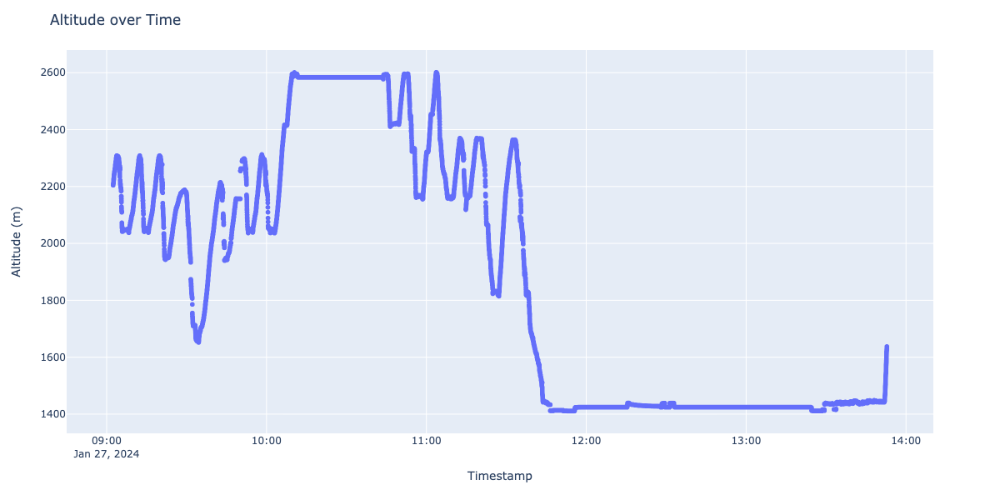

In [14]:
# Verify by plotting
plot_total_alt_over_time(df_resampled)

In [15]:
# If needed: Export resampled dataframe to csv
name_of_csv_resampled='df_290_resampled.csv'
df_resampled.to_csv(name_of_csv_resampled, index=False)

# Label data to prepare df for supervised learning

In [16]:
# Assign dataframe that is yet to be labeled
df_to_be_labeled=df_resampled
initial_shape_df_to_be_labeled=df_to_be_labeled.shape
print(f'Initial shape: {initial_shape_df_to_be_labeled}')

Initial shape: (17424, 44)


In [17]:
# Check for missing values and drop rows with missing values
df_to_be_labeled.isnull().sum()

Timestamp                   0
accelX(g)                   0
accelY(g)                   0
accelZ(g)                   0
accelUserX(g)               0
accelUserY(g)               0
accelUserZ(g)               0
gyroX(rad/s)                0
gyroY(rad/s)                0
gyroZ(rad/s)                0
Roll(rads)                  0
Pitch(rads)                 0
Yaw(rads)                   0
m11                         0
m12                         0
m13                         0
m21                         0
m22                         0
m23                         0
m31                         0
m32                         0
m33                         0
qX                          0
qY                          0
qZ                          0
qW                          0
Lat                         0
Long                        0
Speed(m/s)                  0
TrueHeading                 0
Alt(m)                      0
HorizontalAccuracy(m)       0
VerticalAccuracy(m)         0
Course    

In [18]:
# Drop rows with any missing values
df_to_be_labeled.dropna(inplace=True)
print(f'Initial shape: {initial_shape_df_to_be_labeled}')
print(f'New shape: {df_to_be_labeled.shape}')

Initial shape: (17424, 44)
New shape: (17424, 44)


In [19]:
map_tracked_movement(df_to_be_labeled)

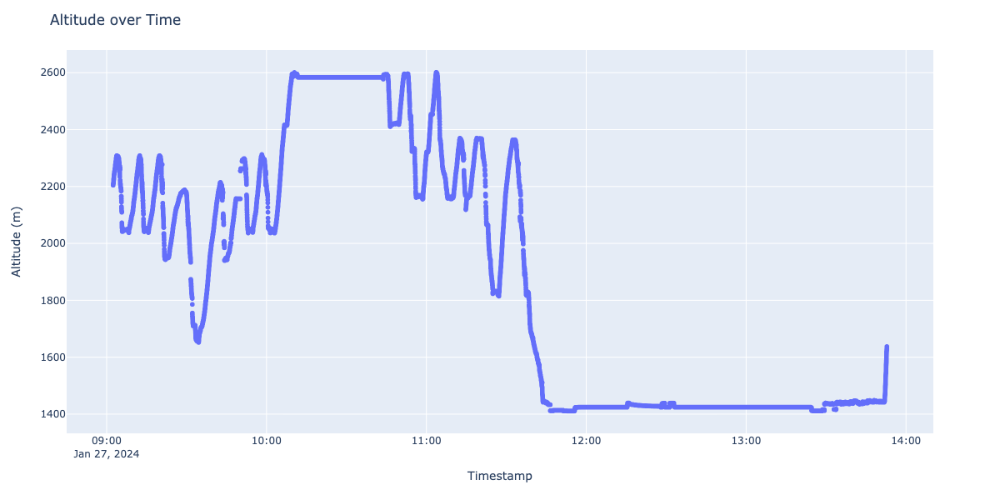

In [20]:
# Plot alt over time 
plot_total_alt_over_time(df_to_be_labeled)

# Get time stamps from hovering over plot 

In [49]:
# Add 'on_lift' column to df and set all values to 0
df_to_be_labeled['on_lift'] = 0

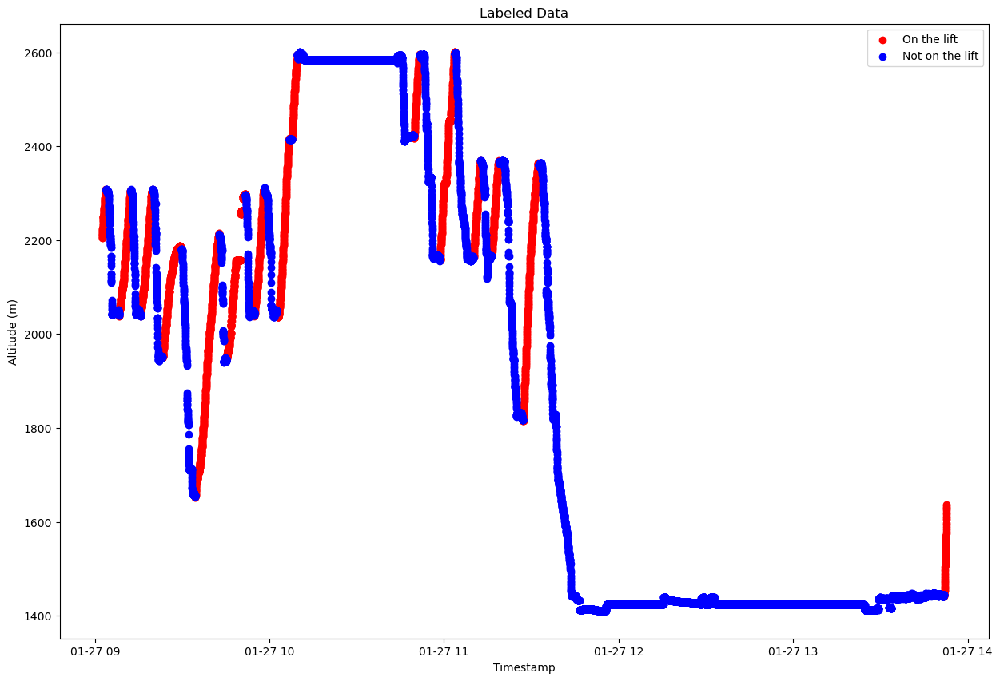

In [50]:
# Manually noted timestamps for lift rides
lift_rides = [
    ('2024-01-27 09:02:26', '2024-01-27 09:03:46'),
    ('2024-01-27 09:08:19', '2024-01-27 09:12:16'),
    ('2024-01-27 09:15:43', '2024-01-27 09:19:45'),
    ('2024-01-27 09:23:06', '2024-01-27 09:29:37'),
    ('2024-01-27 09:34:28', '2024-01-27 09:42:44'),
    ('2024-01-27 09:45:12', '2024-01-27 09:51:42'),
    ('2024-01-27 09:54:50', '2024-01-27 09:58:11'),
    ('2024-01-27 10:02:30', '2024-01-27 10:06:51'),
    ('2024-01-27 10:07:37', '2024-01-27 10:09:36'),
    ('2024-01-27 10:49:36', '2024-01-27 10:51:43'),
    ('2024-01-27 10:58:37', '2024-01-27 11:03:44'),
    ('2024-01-27 11:10:05', '2024-01-27 11:12:35'),
    ('2024-01-27 11:16:20', '2024-01-27 11:18:55'),
    ('2024-01-27 11:27:05', '2024-01-27 11:32:35'),
    ('2024-01-27 13:51:51', '2024-01-27 13:52:49'),
]

# Iterate and relabel df 
for start, end in lift_rides:
    # Update 'on_lift' column for rows where the timestamp falls within the lift ride's duration
    df_to_be_labeled.loc[(df_to_be_labeled['Timestamp'] >= start) & (df_to_be_labeled['Timestamp'] <= end), 'on_lift'] = 1

# Show plot with colored labels 
plot_manual_labeling(df_to_be_labeled)

# Show map with lift rides only 
lift_rides_map = map_lift_rides(df_to_be_labeled)
lift_rides_map

# Export

In [51]:
# export to CSV
name_of_csv_labeled='df_290_labeled.csv'
df_to_be_labeled.to_csv(name_of_csv_labeled, index=False)